In [1]:
import os
import kagglehub
import numpy as np
from skimage.io import imread
import matplotlib.pyplot as plt
from utils import *

os.makedirs("figures", exist_ok=True)

c:\nextcloud\Studia - PW\semestr 6\biometria\projekt2\Iris\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Dataset

[MMU Iris Dataset](https://www.kaggle.com/datasets/naureenmohammad/mmu-iris-dataset)

In [2]:
path = kagglehub.dataset_download("naureenmohammad/mmu-iris-dataset")

In [3]:
imgs_info = []
for dir, _, files in sorted(os.walk(path)):
    idx = dir.split("MMU-Iris-Database/")[-1].split("/")[0]
    if dir.endswith("left"):
        class_name = "left"
    elif dir.endswith("right"):
        class_name = "right"
    else:
        continue

    for file in files:
        no = file.split(".")[0][-1]
        if file.endswith(".bmp"):
            imgs_info.append((dir, file, f"{idx}-{no}", class_name))

In [4]:
imgs_dt = []
for dir, file, idx, class_name in imgs_info:
    img = imread(os.path.join(dir, file))
    imgs_dt.append((img, f"{class_name}_{idx}"))

In [5]:
imgs_dt[0][0].shape

(240, 320, 3)

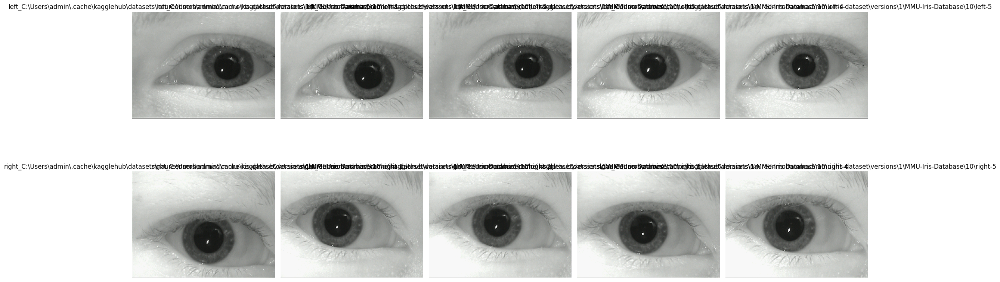

In [6]:
fig, axs = plt.subplots(2, 5, figsize=(20, 10))

for i, (img, label) in enumerate(imgs_dt[:10]):
    axs[i // 5, i % 5].imshow(img)
    axs[i // 5, i % 5].set_title(label)
    axs[i // 5, i % 5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "eyes_presentation.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

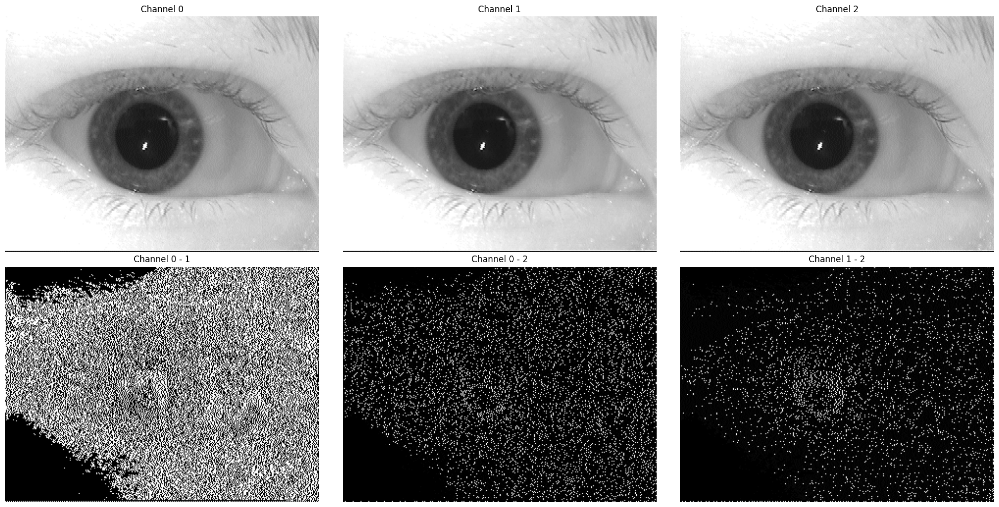

In [7]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10))
axs = axs.ravel()

axs[0].imshow(img[:, :, 0], cmap="gray")
axs[0].set_title("Channel 0")
axs[0].axis("off")

axs[1].imshow(img[:, :, 1], cmap="gray")
axs[1].set_title("Channel 1")
axs[1].axis("off")

axs[2].imshow(img[:, :, 2], cmap="gray")
axs[2].set_title("Channel 2")
axs[2].axis("off")

axs[3].imshow(img[:, :, 0] - img[:, :, 1], cmap="gray")
axs[3].set_title("Channel 0 - 1")
axs[3].axis("off")

axs[4].imshow(img[:, :, 0] - img[:, :, 2], cmap="gray")
axs[4].set_title("Channel 0 - 2")
axs[4].axis("off")

axs[5].imshow(img[:, :, 1] - img[:, :, 2], cmap="gray")
axs[5].set_title("Channel 1 - 2")
axs[5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "channels_differences.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [8]:
imgs_original = []

for i in range(len(imgs_dt)):
    img = imgs_dt[i][0]
    imgs_original.append(img)
    imgs_dt[i] = (
        0.2989 * img[:, :, 0] + 0.5870 * img[:, :, 1] + 0.1140 * img[:, :, 2],
        imgs_dt[i][1],
    )

imgs_original = np.array(imgs_original)
imgs = np.array([img[0] for img in imgs_dt])
labels = np.array([img[1] for img in imgs_dt])

In [9]:
imgs.shape

(450, 240, 320)

# Detekcja granic źrenicy

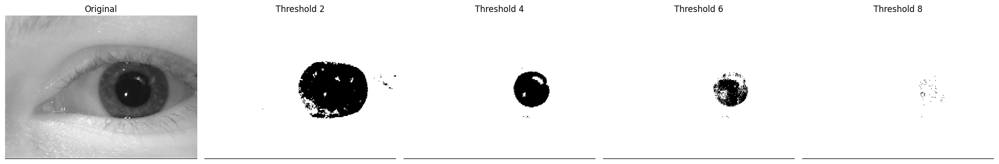

In [10]:
fig, axs = plt.subplots(1, 5, figsize=(20, 10))

img = imgs[0]

axs[0].imshow(img, cmap="gray")
axs[0].set_title("Original")
axs[0].axis("off")

p = np.mean(img)

for i, threshold in enumerate(range(2, 9, 2)):
    axs[i + 1].imshow(img < p / threshold, cmap="binary")
    axs[i + 1].set_title(f"Threshold {threshold}")
    axs[i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

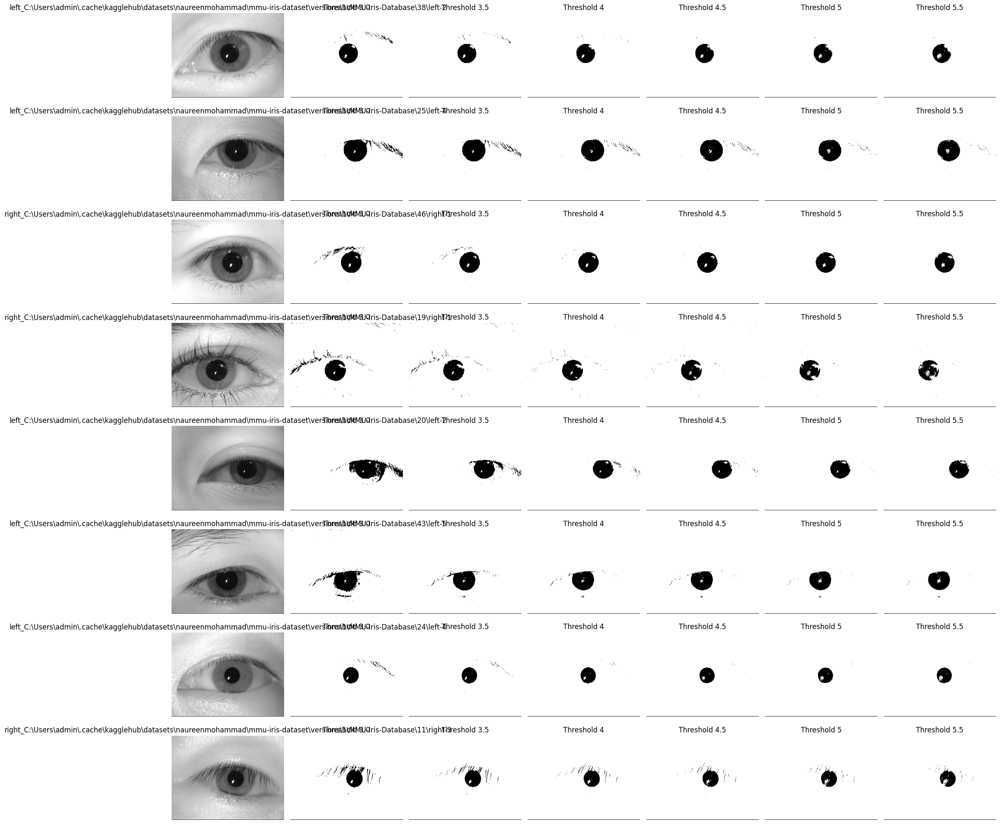

In [11]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

random_idxs = np.random.randint(0, imgs.shape[0], 8)

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    for i, threshold in enumerate([3.0, 3.5, 4, 4.5, 5, 5.5]):
        axs[idx + i + 1].imshow(img < p / threshold, cmap="binary")
        axs[idx + i + 1].set_title(f"Threshold {threshold}")
        axs[idx + i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

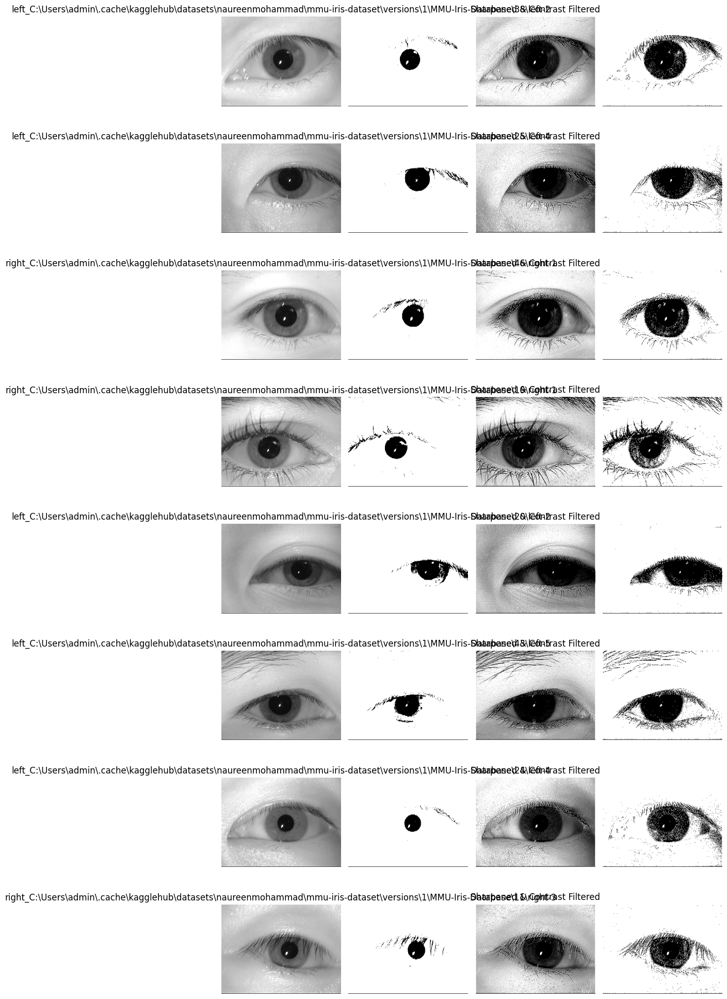

In [12]:
fig, axs = plt.subplots(8, 4, figsize=(10, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(img < p / 3.0, cmap="binary")
    axs[idx + 1].axis("off")

    transformed_img = contrast_filter(sharpen(img))
    p = np.mean(transformed_img)

    axs[idx + 2].imshow(transformed_img, cmap="gray")
    axs[idx + 2].set_title("Sharpened & Contrast Filtered")
    axs[idx + 2].axis("off")

    axs[idx + 3].imshow(transformed_img < p / 3.0, cmap="binary")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "eye_filters_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

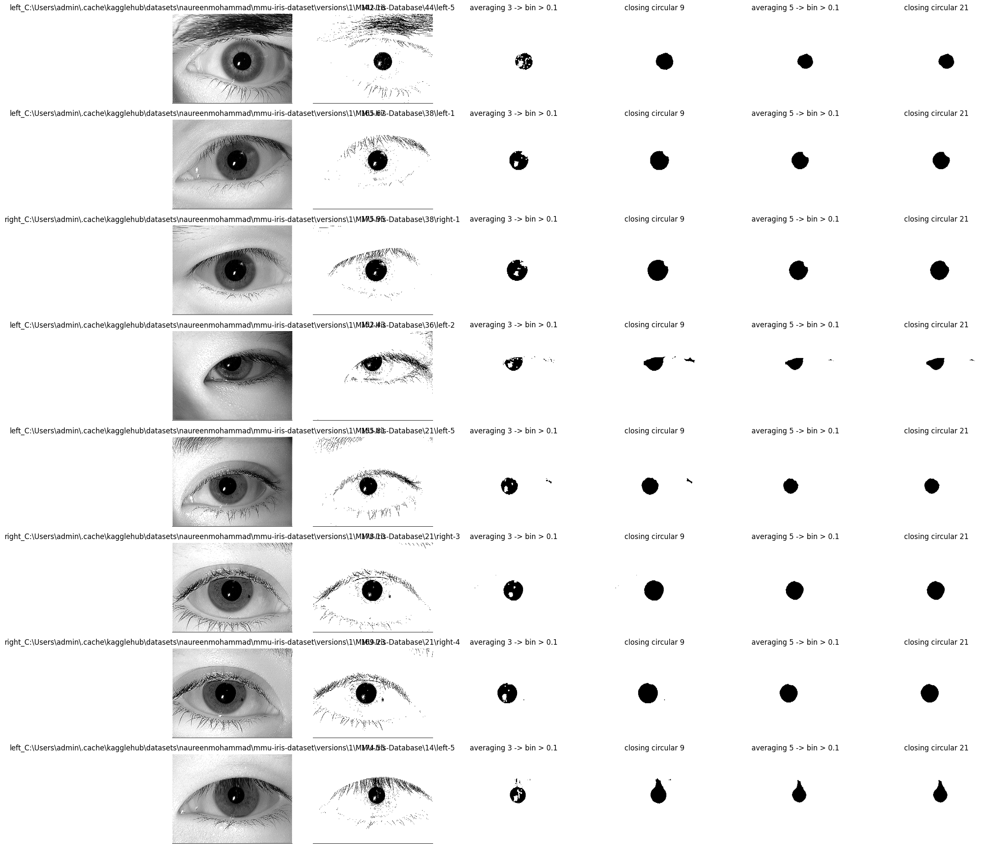

In [13]:
fig, axs = plt.subplots(8, 6, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
for j, k in enumerate([374, 300, 305, 281, 124, 127, 128, 44]):
    img = contrast_filter(sharpen(imgs[k, :, :]), factor=1.2)
    label = labels[k]
    idx = 6 * j
    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    img_bin = img < p / 6.0
    axs[idx + 1].imshow(img_bin, cmap="binary")
    axs[idx + 1].set_title(f"{p:.2f}")
    axs[idx + 1].axis("off")

    img_bin = mask_boundary(img_bin, 50)
    img_blur = averaging_filter(img_bin.astype(np.float32), kernel_size=3)
    img_bin = img_blur > 0.1
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title(f"averaging 3 -> bin > 0.1")
    axs[idx + 2].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(9))
    axs[idx + 3].imshow(img_closed, cmap="binary")
    axs[idx + 3].set_title("closing circular 9")
    axs[idx + 3].axis("off")

    img_blur = averaging_filter(img_closed.astype(np.float32), kernel_size=5)
    img_bin = img_blur > 0.1
    axs[idx + 4].imshow(img_bin, cmap="binary")
    axs[idx + 4].set_title(f"averaging 5 -> bin > 0.1")
    axs[idx + 4].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(21))
    axs[idx + 5].imshow(img_closed, cmap="binary")
    axs[idx + 5].set_title("closing circular 21")
    axs[idx + 5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pulpis_detection_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

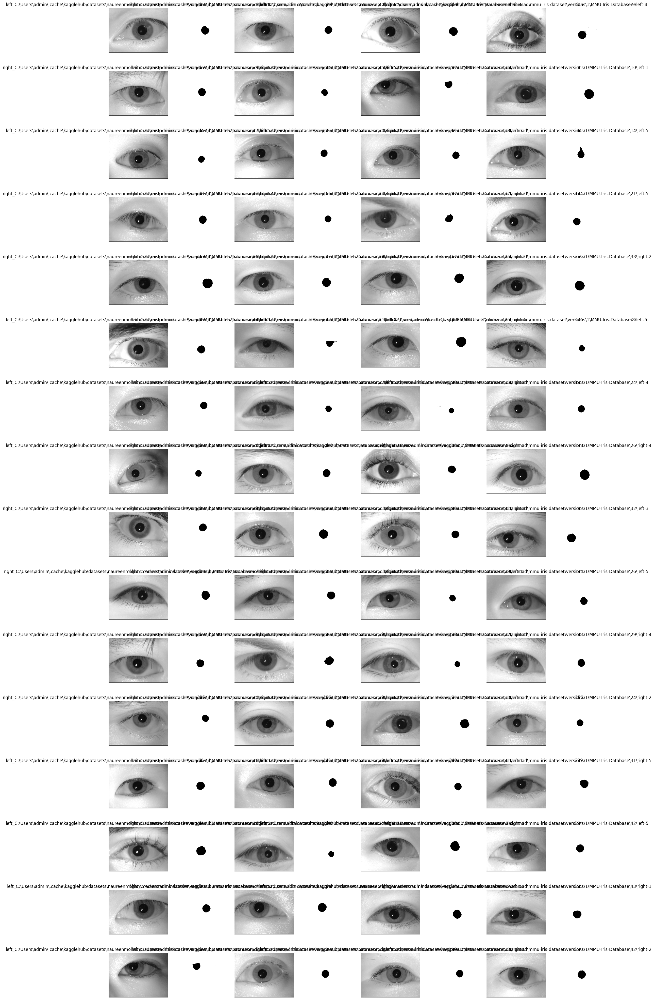

In [14]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 2 * j

    transformed_img = transform_pupil_img(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx + 1].imshow(transformed_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(transformed_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [15]:
pupil_imgs = transform_pupil_imgs(imgs)

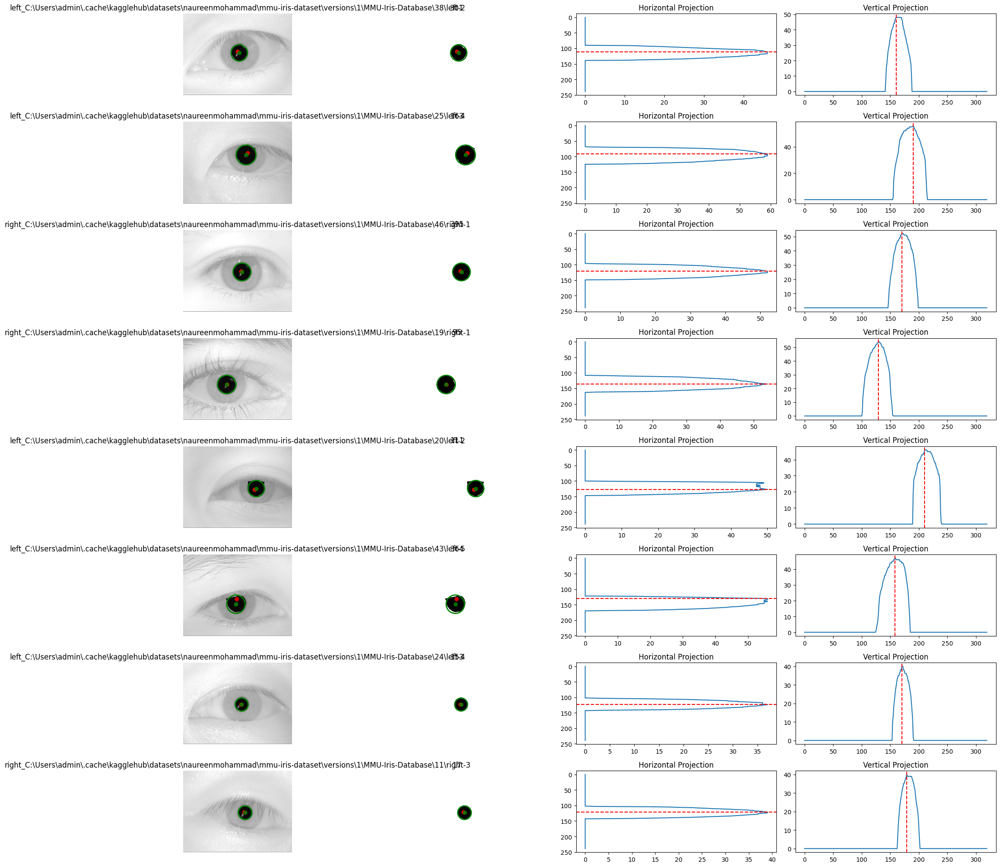

In [16]:
fig, axs = plt.subplots(8, 4, figsize=(20, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].imshow(pupil_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

    vertical_projection = np.sum(pupil_img, axis=0)
    horizontal_projection = np.sum(pupil_img, axis=1)
    max_horizontal = np.argmax(horizontal_projection)
    max_vertical = np.argmax(vertical_projection)

    axs[idx + 2].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 2].invert_yaxis()
    axs[idx + 2].axhline(max_horizontal, color="red", linestyle="--", label="Max")
    axs[idx + 2].set_title("Horizontal Projection")

    axs[idx + 3].plot(vertical_projection)
    axs[idx + 3].axvline(max_vertical, color="red", linestyle="--", label="Max")
    axs[idx + 3].set_title("Vertical Projection")

    axs[idx].plot(max_vertical, max_horizontal, "ro", alpha=0.8)
    axs[idx + 1].plot(max_vertical, max_horizontal, "ro", alpha=0.8)

    x, radius_x = analyse_pupil_projection(vertical_projection)
    y, radius_y = analyse_pupil_projection(horizontal_projection)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx].plot(x, y, "go", alpha=0.8)
    axs[idx + 1].plot(x, y, "go", alpha=0.8)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx].add_patch(circle)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx + 1].add_patch(circle)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_projections_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [17]:
pupils = get_pupils(pupil_imgs)

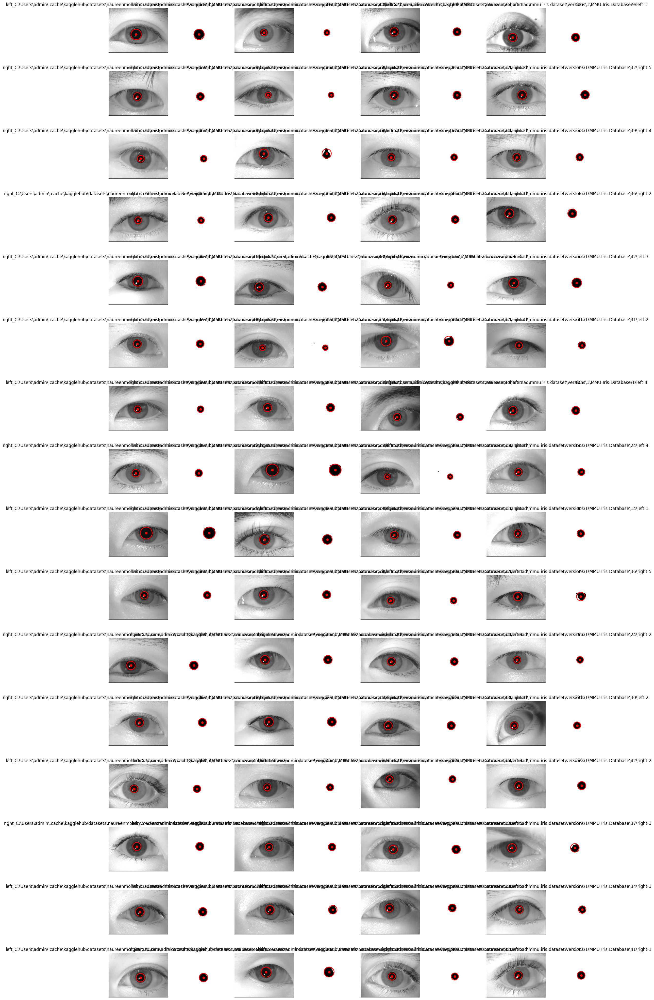

In [18]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = pupils[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Detekcja granic tęczówki

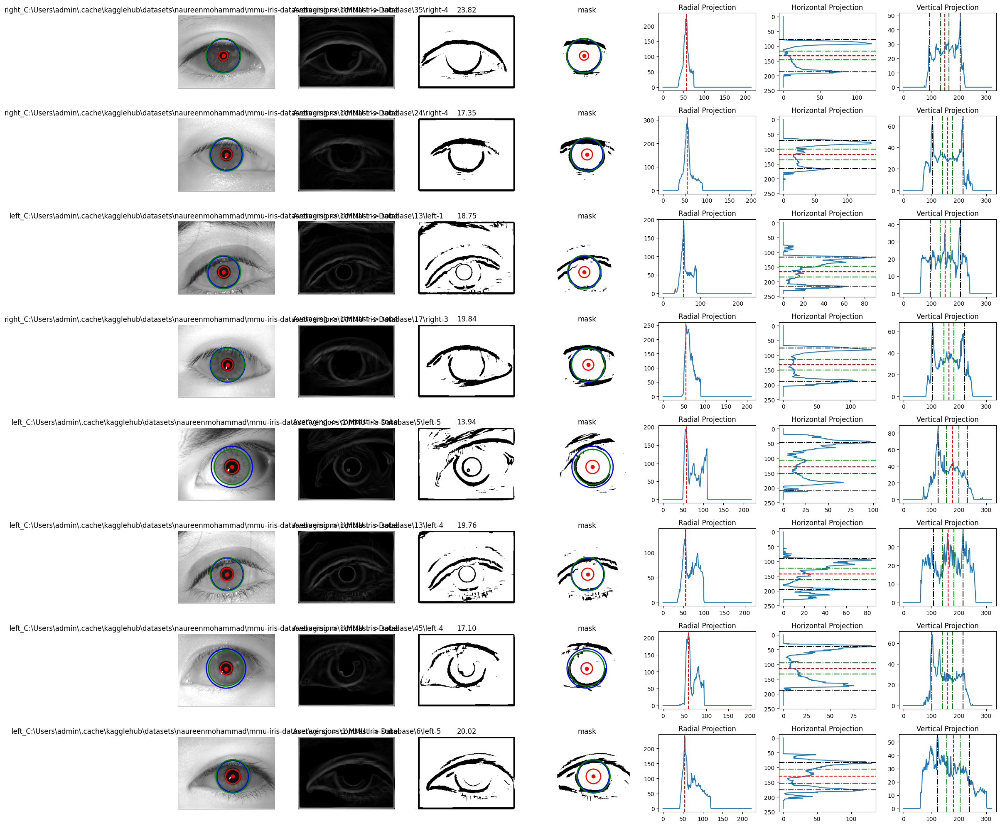

In [19]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
# for j, k in enumerate([300, 305, 281, 124, 127, 128, 44]):
for j, k in enumerate([278, 158, 34, 77, 404, 32, 383, 414]):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    img = sobel_filter(contrast_filter(averaging_filter(img, kernel_size=11)))
    p = np.mean(img)

    axs[idx + 1].imshow(img, cmap="gray")
    axs[idx + 1].set_title("Averaging -> contrast -> sobel")
    axs[idx + 1].axis("off")

    p = np.mean(img)
    img_bin = img > p / 0.7
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title(f"{p:.2f}")
    axs[idx + 2].axis("off")

    (x, y), pupil_radius = pupils[k]
    img_bin = mask_boundary(img_bin, 10)
    img_bin = mask_circle(img_bin, (x, y), 5 * pupil_radius)
    img_bin = mask_circle(img_bin, (x, y), 1.8 * pupil_radius, inside=False)
    img_bin = img_bin & ~pupil_imgs[k, :, :]

    axs[idx + 3].imshow(img_bin, cmap="binary")
    axs[idx + 3].set_title(f"mask")
    axs[idx + 3].axis("off")

    vertical_projection = np.sum(img_bin, axis=0)
    horizontal_projection = np.sum(img_bin, axis=1)
    radial_projection = get_radial_projection(img_bin, (x, y))

    iris_radus_radial = np.argmax(radial_projection)

    axs[idx + 4].plot(radial_projection)
    axs[idx + 4].set_title("Radial Projection")
    axs[idx + 4].axvline(iris_radus_radial, color="red", linestyle="--", label="Max")

    radius_x = analyse_iris_projection(
        x, pupil_radius=pupil_radius, vector=vertical_projection
    )
    radius_y = analyse_iris_projection(
        y, pupil_radius=pupil_radius, vector=horizontal_projection
    )
    # iris_radius = max(radius_x, radius_y)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx + 5].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 5].axhline(y, color="red", linestyle="--", label="Max")
    axs[idx + 5].axhline(y + pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y - pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y + radius_y, color="black", linestyle="-.")
    axs[idx + 5].axhline(y - radius_y, color="black", linestyle="-.")
    axs[idx + 5].invert_yaxis()
    axs[idx + 5].set_title("Horizontal Projection")

    axs[idx + 6].plot(vertical_projection)
    axs[idx + 6].axvline(x, color="red", linestyle="--", label="Max")
    axs[idx + 6].axvline(x + pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x - pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x + radius_x, color="black", linestyle="-.")
    axs[idx + 6].axvline(x - radius_x, color="black", linestyle="-.")
    axs[idx + 6].set_title("Vertical Projection")

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx + 3].plot(x, y, "ro")
    axs[idx + 3].add_patch(circle_pupil)
    axs[idx + 3].add_patch(circle_iris)
    axs[idx + 3].add_patch(circle_iris_radial)

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx].plot(x, y, "ro")
    axs[idx].add_patch(circle_pupil)
    axs[idx].add_patch(circle_iris)
    axs[idx].add_patch(circle_iris_radial)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detection_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [20]:
iris_imgs = transform_iris_imgs(imgs, pupils)

In [21]:
irises = get_irises(iris_imgs, pupils)

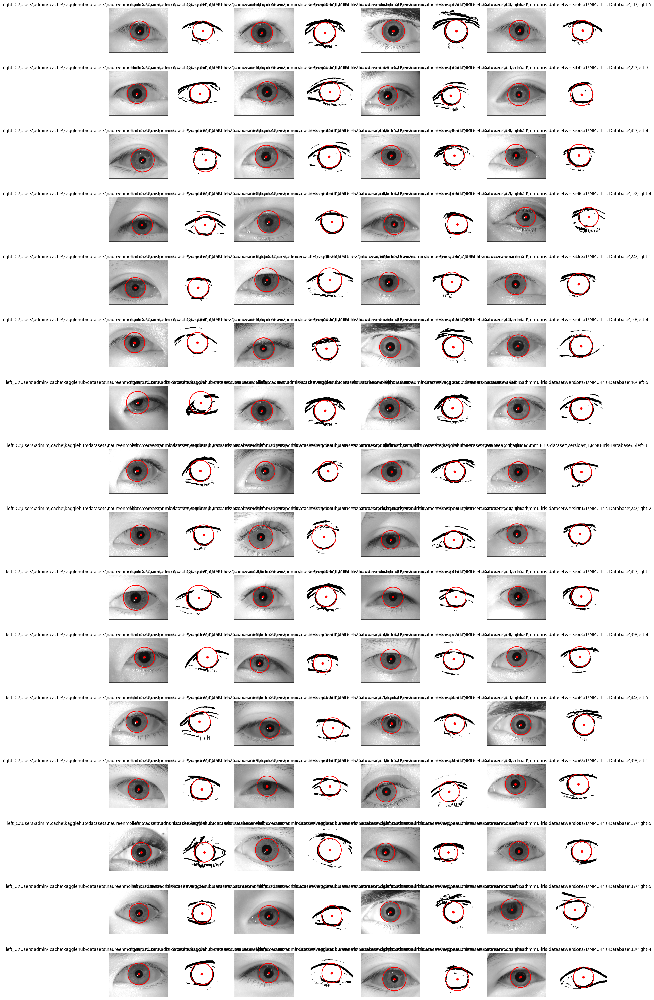

In [22]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    center, iris_radius = irises[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detected_many.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Cropping the iris

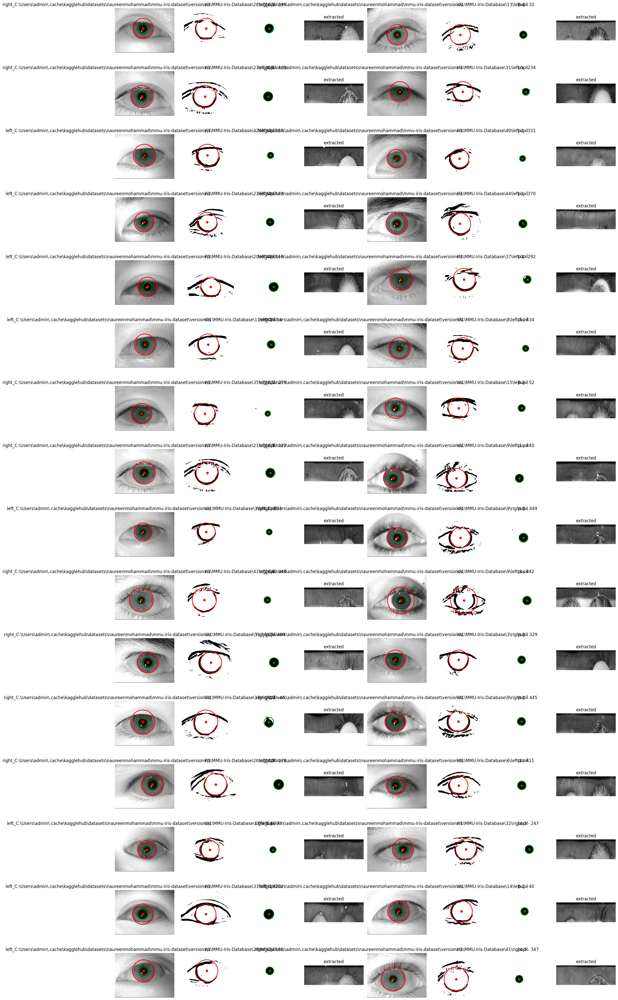

In [23]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 32)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = irises[k]
    _, pulipl_radius = pupils[k]
    label = labels[k]
    idx = 4 * j

    iris_circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    pupil_circle = plt.Circle(
        center, pulipl_radius, color="green", fill=False, linewidth=2
    )
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(iris_circle)
    axs[idx].add_patch(pupil_circle)
    axs[idx].set_title(f"{label} - {k}")
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title("iris")
    axs[idx + 1].axis("off")

    circle = plt.Circle(center, pulipl_radius, color="green", fill=False, linewidth=2)
    axs[idx + 2].imshow(pupil_img, cmap="binary")
    axs[idx + 2].plot(*center, "go")
    axs[idx + 2].add_patch(circle)
    axs[idx + 2].set_title("pupil")
    axs[idx + 2].axis("off")

    iris_part = unwrap_annular_segment(img, center, pulipl_radius, iris_radius)
    axs[idx + 3].imshow(iris_part, cmap="gray")
    axs[idx + 3].set_title("extracted")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "final_comphrasion.png"),
    dpi=300,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [24]:
irises_parts = get_irises_parts(imgs_original, pupils, irises)

In [25]:
irises_parts.shape

(450, 50, 150, 3)

# Saving Results

In [26]:
import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    save_imgs(imgs, iris_imgs, pupil_imgs, irises_parts, irises, pupils, labels)

# Daugman's Algorithm

In [27]:
base_dirs = {
        "images": "data/images",
        "extracted_irises": "data/extracted_irises",
        "irises": "data/irises",
        "pupils": "data/pupils",
    }

extracted_irises_dir = base_dirs["extracted_irises"]

## Sample image loaded

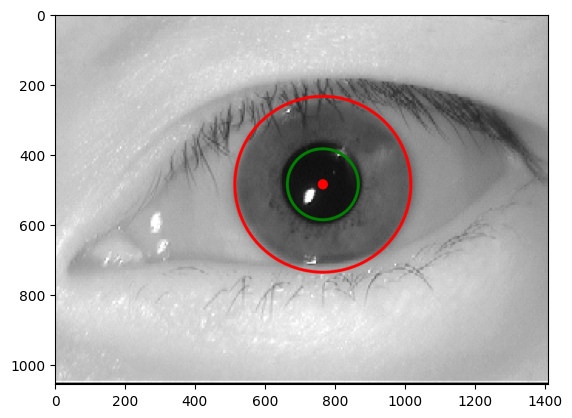

In [28]:
original_image = imread("data/images/left/38-1.png")
plt.imshow(original_image, cmap="gray")

(470, 1410)

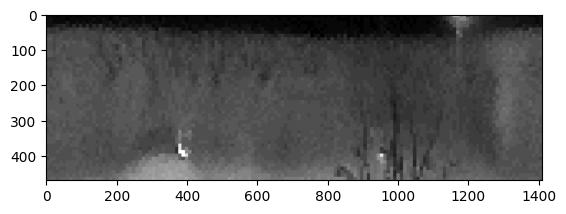

In [29]:
sample_image = imread("data/extracted_irises/left/38-1.png")[:, :, 0]
plt.imshow(sample_image, cmap="gray")
sample_image.shape

(440, 1410)

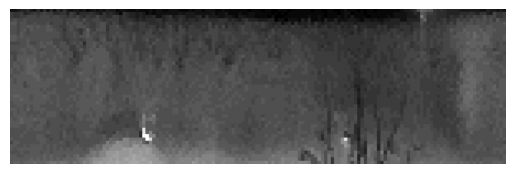

In [30]:
rows_to_remove = sample_image.shape[0] - 440 # so that it is divisible by 8 (like the 8 bands we use)
cropped_image = sample_image[rows_to_remove:, :]

plt.imshow(cropped_image, cmap="gray")
plt.axis("off")

cropped_image.shape

Frequency has a major effects both on the resulting code as well as the distance difference between different people

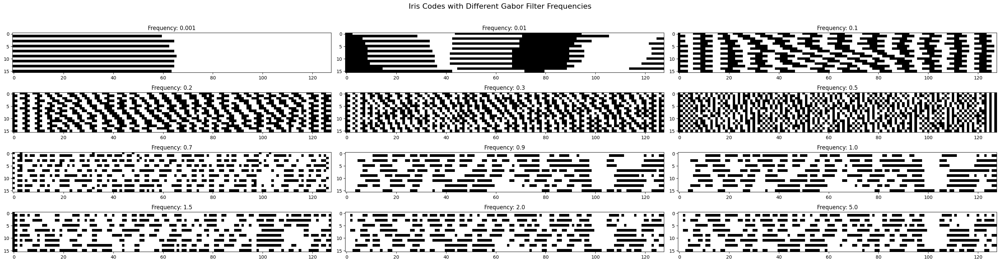

In [31]:
frequencies = [0.001, 0.01, 0.1, 0.2, 0.3, 0.5, 0.7, 0.9, 1.0, 1.5, 2.0, 5.0]

fig, axes = plt.subplots(4, 3, figsize=(30, 8))
axes = axes.flatten()

for i, freq in enumerate(frequencies):
    iris_code = image_to_iris_code_2(sample_image, gabor_frequency=freq)
    ax = axes[i]
    im = ax.imshow(iris_code, cmap="gray")
    ax.set_title(f"Frequency: {freq}")

plt.tight_layout()
fig.suptitle("Iris Codes with Different Gabor Filter Frequencies", fontsize=16)
plt.subplots_adjust(top=0.9) 

plt.show()

## Effect on seperation between people

In [32]:
iris_grouped = {}
filenames = []

for filename in os.listdir(extracted_irises_dir+"/left"):
    name_split = filename.replace(".png", "").split("-")
    iris_id = name_split[0]
    if iris_grouped.get(iris_id) is None:
        iris_grouped[iris_id] = []
    if filename.endswith(".png"):
        iris_grouped[iris_id].append(filename)
        filenames.append(filename)

print(iris_grouped)
print(f"Number of iris groups: {len(iris_grouped)}")

{'1': ['1-1.png', '1-2.png', '1-3.png', '1-4.png', '1-5.png'], '10': ['10-1.png', '10-2.png', '10-3.png', '10-4.png', '10-5.png'], '11': ['11-1.png', '11-2.png', '11-3.png', '11-4.png', '11-5.png'], '12': ['12-1.png', '12-2.png', '12-3.png', '12-4.png', '12-5.png'], '13': ['13-1.png', '13-2.png', '13-3.png', '13-4.png', '13-5.png'], '14': ['14-1.png', '14-2.png', '14-3.png', '14-4.png', '14-5.png'], '15': ['15-1.png', '15-2.png', '15-3.png', '15-4.png', '15-5.png'], '16': ['16-1.png', '16-2.png', '16-3.png', '16-4.png', '16-5.png'], '17': ['17-1.png', '17-2.png', '17-3.png', '17-4.png', '17-5.png'], '18': ['18-1.png', '18-2.png', '18-3.png', '18-4.png', '18-5.png'], '19': ['19-1.png', '19-2.png', '19-3.png', '19-4.png', '19-5.png'], '2': ['2-1.png', '2-2.png', '2-3.png', '2-4.png', '2-5.png'], '20': ['20-1.png', '20-2.png', '20-3.png', '20-4.png', '20-5.png'], '21': ['21-1.png', '21-2.png', '21-3.png', '21-4.png', '21-5.png'], '22': ['22-1.png', '22-2.png', '22-3.png', '22-4.png', '22-

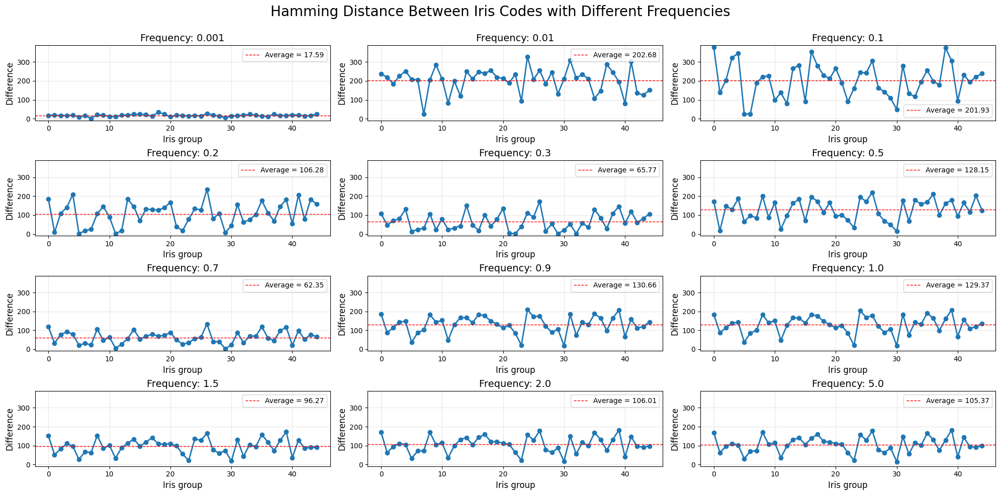

In [33]:
fig, axes = plt.subplots(4, 3, figsize=(20, 10))
axes = axes.flatten()

all_differences = []

for i, freq in enumerate(frequencies):
    iris_codes = {}
    gabor_frequency = freq
    for filename in filenames:
        iris_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", filename))[:, :, 0], 
                                         gabor_frequency=gabor_frequency)
        iris_codes[filename] = iris_code
    
    differences = []
    for key in iris_grouped.keys():
        same_group = []
        differnet_group = []
        for key2 in iris_grouped.keys():
            if key != key2:
                differnet_group += iris_grouped[key2]
            else:
                same_group += iris_grouped[key2]
        
        reference_code = iris_codes[same_group[0]]
        same_group.pop(0)
        
        average_distance_in_group = 0
        for element in same_group:
            hd = int((reference_code != iris_codes[element]).sum())
            average_distance_in_group += hd
        average_distance_in_group /= len(same_group) if same_group else 1
        
        average_distance_in_different_group = 0
        sample_different = differnet_group
        group_len = 0
        for element in sample_different:
            hd = int((reference_code != iris_codes[element]).sum())
            average_distance_in_different_group += hd
            group_len += 1
        if group_len > 0:
            average_distance_in_different_group /= group_len
        differences.append(abs(average_distance_in_different_group - average_distance_in_group))
    
    all_differences.extend(differences)
    
    ax = axes[i]
    ax.plot(differences, marker='o', linewidth=2)
    ax.set_title(f"Frequency: {freq}", fontsize=14)
    
    avg = np.mean(differences)
    ax.axhline(y=avg, color='red', linestyle='--', linewidth=1, 
               label=f'Average = {avg:.2f}')
    
    ax.set_xlabel("Iris group", fontsize=12)
    ax.set_ylabel("Difference", fontsize=12)
    ax.legend(fontsize=10)
    ax.grid(True, alpha=0.3)

y_min = min(all_differences) - 10
y_max = max(all_differences) + 10
for ax in axes:
    ax.set_ylim(y_min, y_max)

plt.tight_layout()
fig.suptitle("Hamming Distance Between Iris Codes with Different Frequencies", fontsize=20)
plt.subplots_adjust(top=0.9)
plt.show()

Based on the test, the best frequency is 0.5, so that's the frequency we'll use from now on

In [34]:
best_gabor_frequency = 0.1

## Daughman demo

### Helpers

In [35]:
def compare_codes(iris_code1, iris_code2):
    """
    Compare two iris codes and return the Hamming distance.
    """
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].imshow(iris_code1, cmap="gray")
    axes[0].set_title("Iris Code 1")
    
    axes[1].imshow(iris_code2, cmap="gray")
    axes[1].set_title("Iris Code 2")

    axes[2].imshow(iris_code1 != iris_code2, cmap="gray")
    axes[2].set_title("Difference")

    hamming_distance = int((iris_code1 != iris_code2).sum())
    print(f"Hamming distance: {hamming_distance}. Total bits: {iris_code1.size}. Percentage: {hamming_distance / iris_code1.size:.2%}") 
    return hamming_distance

def get_cropped_bands_rescaled(
    input_image,
    plot=False,
    number_of_bands=8,
    plot_iris_code=False,
    gabor_frequency=0.25,
):
    image_temp = copy.deepcopy(input_image)
    rows_to_remove = image_temp.shape[0] - 440
    cropped_image = image_temp[rows_to_remove:, :]

    band_height = cropped_image.shape[0] // number_of_bands
    bands = []
    for i in range(number_of_bands):
        start_row = i * band_height
        end_row = (
            (i + 1) * band_height
            if i != number_of_bands - 1
            else cropped_image.shape[0]
        )
        band = cropped_image[start_row:end_row, :]
        bands.append(band)
        # print(band.shape)

    bands_specifications = {
        **{  # Bands 0-3: Top cutout 130, no bottom cutout
            str(i): {"top_cutout_width": 130, "bottom_cutout_width": 0}
            for i in range(number_of_bands // 2)
        },
        **{  # Bands 4-5: Top cutout 322, bottom cutout 320
            str(i): {"top_cutout_width": 322, "bottom_cutout_width": 320}
            for i in range(number_of_bands // 2, number_of_bands // 2 * 3 // 4)
        },
        **{  # Bands 6-7: Top cutout 386, bottom cutout 384
            str(i): {"top_cutout_width": 386, "bottom_cutout_width": 384}
            for i in range(number_of_bands // 2 * 3 // 4, number_of_bands)
        },
    }

    cropped_bands = []

    for i in range(8):
        top_cutout_width = bands_specifications[str(i)]["top_cutout_width"]
        bottom_cutout_width = bands_specifications[str(i)]["bottom_cutout_width"]

        band = copy.deepcopy(bands[i])

        top_band = copy.deepcopy(band)[:, band.shape[1] // 2 :]
        bottom_band = band[:, : band.shape[1] // 2].copy()

        # print(
        #     f"Original shapes - band: {band.shape}, top_band: {top_band.shape}, bottom_band: {bottom_band.shape}"
        # )

        top_center = top_band.shape[1] // 2
        bottom_center = bottom_band.shape[1] // 2

        if top_cutout_width > 0:
            top_start = top_center - top_cutout_width // 2
            top_end = top_center + top_cutout_width // 2
            top_start = max(0, top_start)
            top_end = min(top_band.shape[1], top_end)
            top_band_cropped = np.delete(top_band, np.s_[top_start:top_end], axis=1)
        else:
            top_band_cropped = top_band

        if bottom_cutout_width > 0:
            bottom_start = bottom_center - bottom_cutout_width // 2
            bottom_end = bottom_center + bottom_cutout_width // 2
            bottom_start = max(0, bottom_start)
            bottom_end = min(bottom_band.shape[1], bottom_end)
            bottom_band_cropped = np.delete(
                bottom_band, np.s_[bottom_start:bottom_end], axis=1
            )
        else:
            bottom_band_cropped = bottom_band

        combined_band = np.concatenate((bottom_band_cropped, top_band_cropped), axis=1)
        cropped_bands.append(combined_band.copy())

    cropped_bands_rescaled = np.stack(
        [downsample_to_128(b) for b in cropped_bands], axis=0
    )
    return cropped_bands_rescaled

### Same person different eyes

Hamming distance: 750. Total bits: 2048. Percentage: 36.62%


750

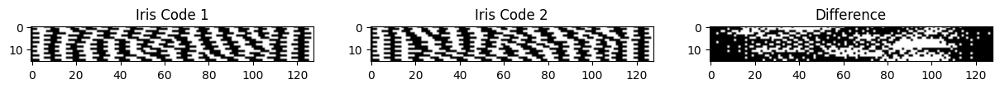

In [36]:
person_1 = iris_grouped["44"]
first_image = person_1[0]
second_image = person_1[0]

first_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "right", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Same person same eye

Hamming distance: 292. Total bits: 2048. Percentage: 14.26%


292

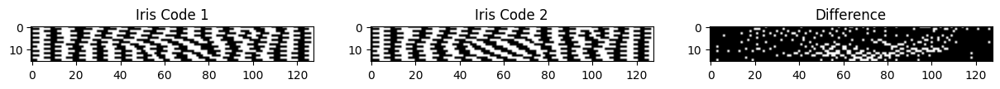

In [37]:
person_1 = iris_grouped["44"]
first_image = person_1[1]
second_image = person_1[2]

first_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Different people

Hamming distance: 889. Total bits: 2048. Percentage: 43.41%


889

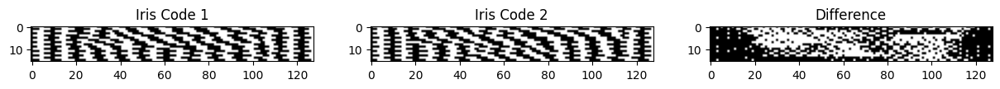

In [38]:
first_image = iris_grouped["14"][0]
second_image = iris_grouped["25"][0]

first_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code_2(imread(os.path.join(extracted_irises_dir, "left", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Entire process demonstrated

Text(0.5, 1.0, 'Final Iris Code')

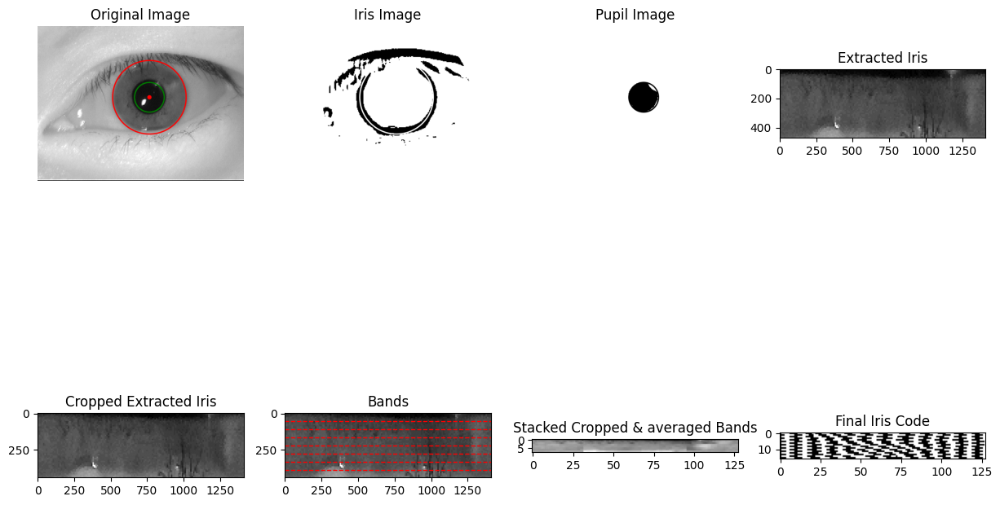

In [39]:
original_image = imread(os.path.join(base_dirs['images'], "left", "38-1.png"))
iris_image = imread(os.path.join(base_dirs['irises'], "left", "38-1.png"))[:, :, 0]
pupil_image = imread(os.path.join(base_dirs["pupils"], "left", "38-1.png"))[:, :, 0]

sample_image_path = os.path.join(base_dirs["extracted_irises"], "left", "38-1.png")

extracted_iris = imread(sample_image_path)[:, :, 0]

rows_to_remove = extracted_iris.shape[0] - 440
cropped_extracted_iris = extracted_iris[rows_to_remove:, :]

bands = np.zeros((extracted_iris.shape[0], extracted_iris.shape[1], 8), dtype=np.uint8)

stacked_cropped_bands = np.vstack(get_cropped_bands_rescaled(
    cropped_image,
    plot=False,
    number_of_bands=8,
    plot_iris_code=False,
    gabor_frequency=0.25,
))

final_code = image_to_iris_code_2(imread(sample_image_path)[:, :, 0], gabor_frequency=best_gabor_frequency)


fig, axes = plt.subplots(2, 4, figsize=(15, 10))

axes[0, 0].imshow(original_image, cmap="gray")
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(iris_image, cmap="gray")  
axes[0, 1].set_title("Iris Image")
axes[0, 1].axis("off")

axes[0, 2].imshow(pupil_image, cmap="gray")
axes[0, 2].set_title("Pupil Image")
axes[0, 2].axis("off")

axes[0, 3].imshow(extracted_iris, cmap="gray")
axes[0, 3].set_title("Extracted Iris")

axes[1, 0].imshow(cropped_extracted_iris, cmap="gray")
axes[1, 0].set_title("Cropped Extracted Iris")

axes[1, 1].imshow(cropped_extracted_iris, cmap="gray")
axes[1, 1].set_title("Bands")

ax_band = axes[1, 1]
ax_band.imshow(cropped_extracted_iris, cmap="gray")
ax_band.set_title("Bands")
total_rows = cropped_extracted_iris.shape[0]
band_height = total_rows / 8

for i in range(1, 8):
    y = i * band_height
    ax_band.axhline(y=y, color="red", linestyle="--", linewidth=1)

axes[1, 2].imshow(stacked_cropped_bands, cmap="gray")
axes[1, 2].set_title("Stacked Cropped & averaged Bands")

axes[1, 3].imshow(final_code, cmap="gray")
axes[1, 3].set_title("Final Iris Code")





### Performance tests

In [40]:
import time

start_time = time.time()
image_read = imread(sample_image_path)[:, :, 0]
stop_image_read = time.time()
print(f"Image read time: {stop_image_read - start_time:.4f} seconds")
start_time = time.time()
final_code = image_to_iris_code_2(image_read, gabor_frequency=best_gabor_frequency)
image_to_code_time_stop = time.time()
image_to_code_time = image_to_code_time_stop - start_time
print(f"Image to code time: {image_to_code_time:.4f} seconds, which is {1/image_to_code_time:.4f} per second.")

Image read time: 0.0055 seconds
Image to code time: 0.0023 seconds, which is 436.4520 per second.


# Other

Number of eyes: 225
0 0
0 1
0 2
0 3
0 4
9 0
9 1
9 2
9 3
9 4
10 0
10 1
10 2
10 3
10 4
11 0
11 1
11 2
11 3
11 4
12 0
12 1
12 2
12 3
12 4
13 0
13 1
13 2
13 3
13 4
14 0
14 1
14 2
14 3
14 4
15 0
15 1
15 2
15 3
15 4
16 0
16 1
16 2
16 3
16 4
17 0
17 1
17 2
17 3
17 4
18 0
18 1
18 2
18 3
18 4
1 0
1 1
1 2
1 3
1 4
19 0
19 1
19 2
19 3
19 4
20 0
20 1
20 2
20 3
20 4
21 0
21 1
21 2
21 3
21 4
22 0
22 1
22 2
22 3
22 4
23 0
23 1
23 2
23 3
23 4
24 0
24 1
24 2
24 3
24 4
25 0
25 1
25 2
25 3
25 4
26 0
26 1
26 2
26 3
26 4
27 0
27 1
27 2
27 3
27 4
28 0
28 1
28 2
28 3
28 4
2 0
2 1
2 2
2 3
2 4
29 0
29 1
29 2
29 3
29 4
30 0
30 1
30 2
30 3
30 4
31 0
31 1
31 2
31 3
31 4
32 0
32 1
32 2
32 3
32 4
33 0
33 1
33 2
33 3
33 4
34 0
34 1
34 2
34 3
34 4
35 0
35 1
35 2
35 3
35 4
36 0
36 1
36 2
36 3
36 4
37 0
37 1
37 2
37 3
37 4
38 0
38 1
38 2
38 3
38 4
39 0
39 1
39 2
39 3
39 4
40 0
40 1
40 2
40 3
40 4
41 0
41 1
41 2
41 3
41 4
42 0
42 1
42 2
42 3
42 4
43 0
43 1
43 2
43 3
43 4
44 0
44 1
44 2
44 3
44 4
45 0
45 1
45 2
45 3
45 4


C:\Users\admin\AppData\Local\Temp\ipykernel_43284\4099560598.py:18: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


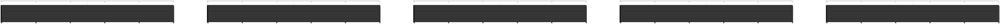

In [53]:
original_images = os.listdir(os.path.join(base_dirs["images"], "left"))
original_images = [
    os.path.join(base_dirs["images"], "left", img) for img in original_images
]

number_of_eyes = len(original_images)
print(f"Number of eyes: {number_of_eyes}")

fig, axes = plt.subplots(number_of_eyes, 5, figsize=(number_of_eyes, 5))

for original_image in original_images:
    eye_id = int(original_image.split("\\")[-1].split("-")[0]) -1
    eye_number = int(original_image.split("\\")[-1].split("-")[1].split(".")[0]) -1
    print(eye_id, eye_number)
    axes[eye_id][eye_number].imshow(imread(original_image), cmap="gray")
    axes[eye_id][eye_number].axis("off")

plt.tight_layout()

